# install dependencies
please restart runtime session after installing the dependencies!

In [ ]:
# install dependencies
!pip install datasets seqeval evaluate transformers
! pip install -U accelerate
! pip install -U transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 521.2/521.2 kB 5.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 5.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.1/84.1 kB 11.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 15.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 17.6 MB/s eta 0:00:00
  Created wheel for seqeval: filename=seqeval-1.2.2-py3-none-any.whl size=16162 sha256=f6fe5bfb79d0a7b611e78e4ace37d3aa8203df529fe5f7a1eb984b2ae7b3f5cd
  Stored in directory: /root/.cache/pip/wheels/1a/67/4a/ad4082dd7dfc30f2abfe4d80a2ed5926a506eb8a972b4767fa
Successfully built seqeval
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 265.7/265.7 kB 3.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.3/8.3 MB 42.8 MB/s eta 0:00:00
  Attempting uninstall: transformers
    Found existing installation: transformers 4.35.2
    Uninstall

#set parameters


In [ ]:
masked_training = False
selected_categories = ['PER', 'ORG', 'LOC', 'DIS', 'ANIM']
label_str2ind_dict = {
    "O": 0,
    "B-PER": 1,
    "I-PER": 2,
    "B-ORG": 3,
    "I-ORG": 4,
    "B-LOC": 5,
    "I-LOC": 6,
    "B-ANIM": 7,
    "I-ANIM": 8,
    "B-BIO": 9,
    "I-BIO": 10,
    "B-CEL": 11,
    "I-CEL": 12,
    "B-DIS": 13,
    "I-DIS": 14,
    "B-EVE": 15,
    "I-EVE": 16,
    "B-FOOD": 17,
    "I-FOOD": 18,
    "B-INST": 19,
    "I-INST": 20,
    "B-MEDIA": 21,
    "I-MEDIA": 22,
    "B-MYTH": 23,
    "I-MYTH": 24,
    "B-PLANT": 25,
    "I-PLANT": 26,
    "B-TIME": 27,
    "I-TIME": 28,
    "B-VEHI": 29,
    "I-VEHI": 30,
  }
label_ind2str_dict = {v: k for k,v in label_str2ind_dict.items()}

#Download Dataset

In [ ]:
from datasets import load_dataset

# data_files = {'train': 'dataset/train_en.jsonl', 'test': 'dataset/test_en.jsonl', 'val': 'dataset/val_en.jsonl'}
data_files = {'train': 'https://huggingface.co/datasets/Babelscape/multinerd/resolve/main/train/train_en.jsonl', 'test': 'https://huggingface.co/datasets/Babelscape/multinerd/resolve/main/test/test_en.jsonl', 'val': 'https://huggingface.co/datasets/Babelscape/multinerd/resolve/main/val/val_en.jsonl'}
multinerd_dataset = load_dataset('json', data_files=data_files)


Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Generating val split: 0 examples [00:00, ? examples/s]

In [ ]:
multinerd_dataset

DatasetDict({
    train: Dataset({
        features: ['tokens', 'ner_tags', 'lang'],
        num_rows: 131280
    })
    test: Dataset({
        features: ['tokens', 'ner_tags', 'lang'],
        num_rows: 16454
    })
    val: Dataset({
        features: ['tokens', 'ner_tags', 'lang'],
        num_rows: 16410
    })
})

##Analyze dataset


In [ ]:
# convert dataset to pandas df
import pandas as pd

multinerd_dataset.set_format(type='pandas')

df_dict = {'train':multinerd_dataset['train'][:],
           'val':multinerd_dataset['val'][:],
           'test':multinerd_dataset['test'][:]
}
df_dict['train'].head()

,tokens,ner_tags,lang
0,"[The, type, locality, is, Kīlauea, .]","[0, 0, 0, 0, 5, 0]",en
1,"[Common, components, of, the, herb, layer, in,...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",en
2,"[The, film, starred, Tito, Lusiardo, and, a, 1...","[0, 0, 0, 1, 2, 0, 0, 0, 0, 0, 1, 2, 0]",en
3,"[Created, by, James, Cameron, and, Charles, H....","[0, 0, 1, 2, 0, 1, 2, 2, 0, 0, 0, 1, 2, 0, 0, ...",en
4,"[The, song, was, written, by, Sarah, Buxton, ,...","[0, 0, 0, 0, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0]",en


In [ ]:
# frequency of each label in each split

freq_dict = {'train':{k.replace('B-', ''): 0 for k in label_str2ind_dict.keys() if k.startswith('B-')},
             'val':{k.replace('B-', ''): 0 for k in label_str2ind_dict.keys() if k.startswith('B-')},
             'test':{k.replace('B-', ''): 0 for k in label_str2ind_dict.keys() if k.startswith('B-')}
             }
split = ''
def freq_update(row, f_dict):
  for tag in row:
    if label_ind2str_dict[tag].startswith('B-'):
      f_dict[split][label_ind2str_dict[tag].replace('B-', '')] +=1

for split, df in df_dict.items():
  df['ner_tags'].apply(lambda r: freq_update(r, freq_dict))
# freq_dict
pd.DataFrame.from_dict(freq_dict, orient='index')

,PER,ORG,LOC,ANIM,BIO,CEL,DIS,EVE,FOOD,INST,MEDIA,MYTH,PLANT,TIME,VEHI
train,62987,27641,58665,12736,140,2685,8702,2525,8279,379,6081,569,7436,2540,404
val,7507,2737,7850,1134,14,94,1695,299,2120,34,919,56,1180,322,80
test,5265,3309,12024,1604,8,41,759,352,566,12,458,32,894,289,32


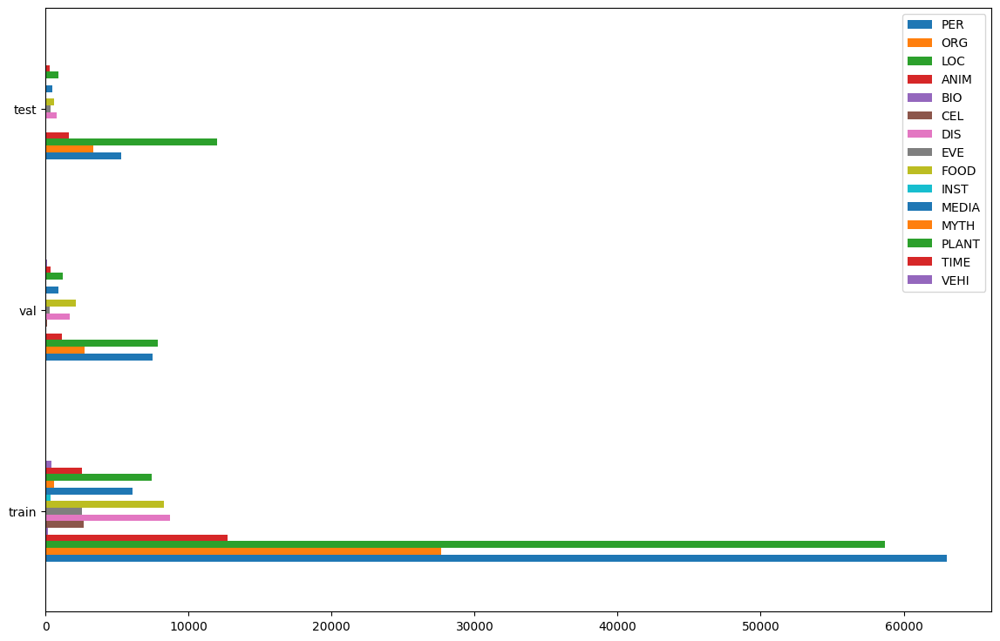

In [ ]:
import matplotlib.pyplot as plt

pd.DataFrame.from_dict(freq_dict, orient='index').plot.barh(figsize=(14,9))
plt.show()

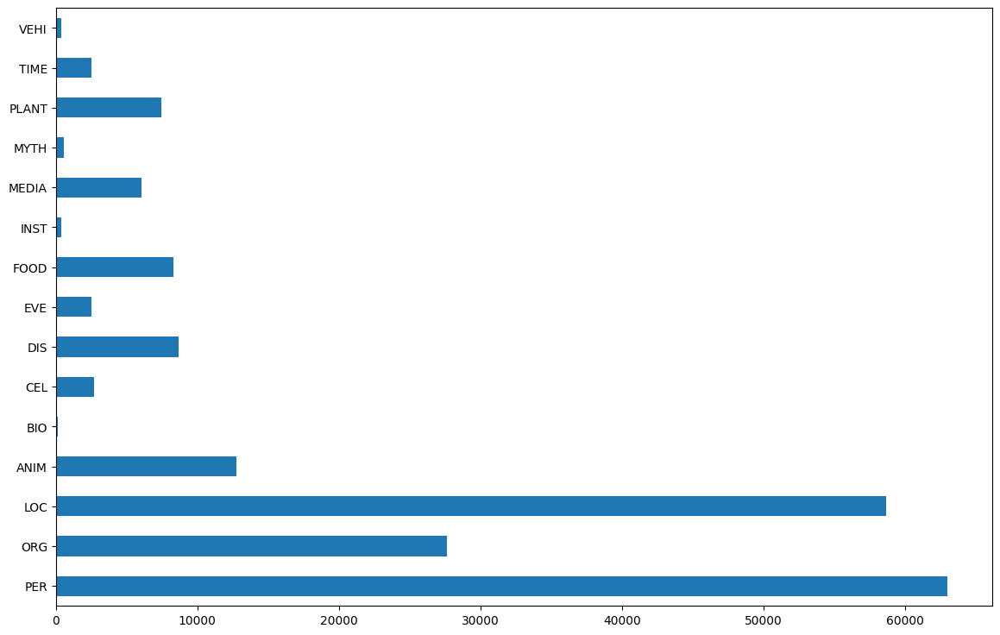

In [ ]:
pd.DataFrame.from_dict(freq_dict, orient='index').loc['train'].plot.barh(figsize=(14,9))
plt.show()

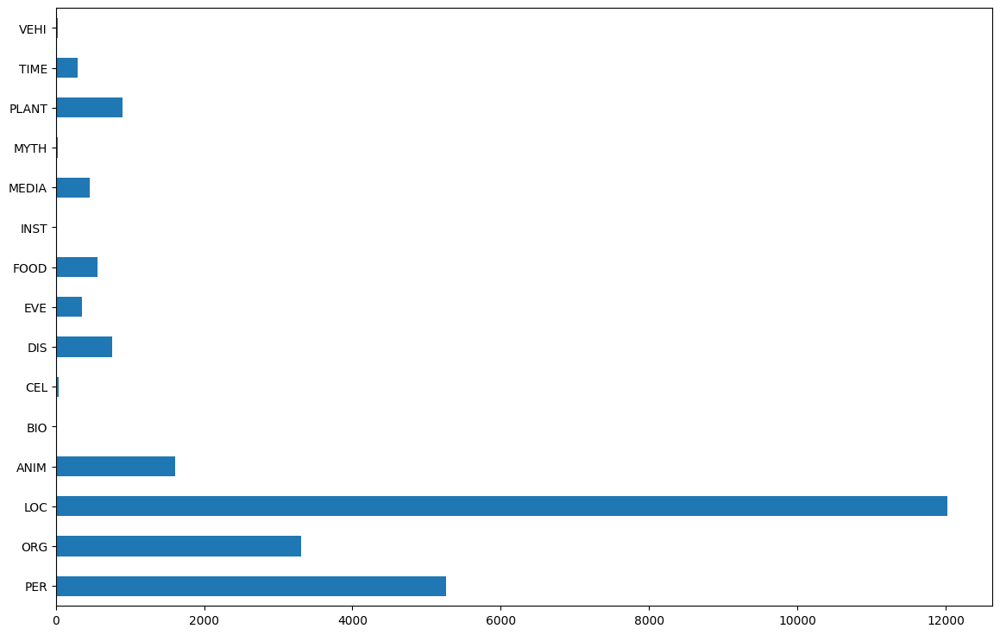

In [ ]:
pd.DataFrame.from_dict(freq_dict, orient='index').loc['test'].plot.barh(figsize=(14,9))
plt.show()

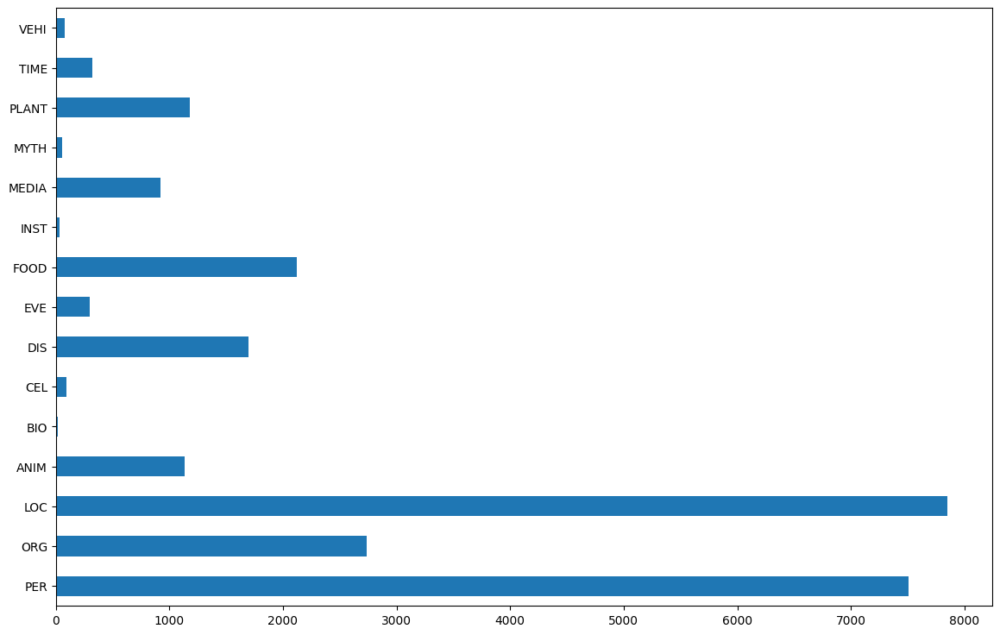

In [ ]:
pd.DataFrame.from_dict(freq_dict, orient='index').loc['val'].plot.barh(figsize=(14,9))
plt.show()

In [ ]:
label_ind2str_dict

{0: 'O',
 1: 'B-PER',
 2: 'I-PER',
 3: 'B-ORG',
 4: 'I-ORG',
 5: 'B-LOC',
 6: 'I-LOC',
 7: 'B-ANIM',
 8: 'I-ANIM',
 9: 'B-BIO',
 10: 'I-BIO',
 11: 'B-CEL',
 12: 'I-CEL',
 13: 'B-DIS',
 14: 'I-DIS',
 15: 'B-EVE',
 16: 'I-EVE',
 17: 'B-FOOD',
 18: 'I-FOOD',
 19: 'B-INST',
 20: 'I-INST',
 21: 'B-MEDIA',
 22: 'I-MEDIA',
 23: 'B-MYTH',
 24: 'I-MYTH',
 25: 'B-PLANT',
 26: 'I-PLANT',
 27: 'B-TIME',
 28: 'I-TIME',
 29: 'B-VEHI',
 30: 'I-VEHI'}

##Analyze masked dataset


In [ ]:
# masking some of the labels
# masked = True
def mask_cats(row):
  new_row = []
  for tag in row:
    if tag == 0:
      new_row.append(0)
    elif label_ind2str_dict[tag].split('-')[1] in selected_categories:
      new_row.append(tag)
    else:
      new_row.append(0)
  return new_row

masked_df_dict = {'train':multinerd_dataset['train'][:].copy(deep=True),
           'val':multinerd_dataset['val'][:].copy(deep=True),
           'test':multinerd_dataset['test'][:].copy(deep=True)
}
for split, df in masked_df_dict.items():
  df['ner_tags'] = df['ner_tags'].apply(mask_cats)

masked_df_dict['train'].head()
# pd.DataFrame.from_dict(freq_dict, orient='index')

,tokens,ner_tags,lang
0,"[The, type, locality, is, Kīlauea, .]","[0, 0, 0, 0, 5, 0]",en
1,"[Common, components, of, the, herb, layer, in,...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",en
2,"[The, film, starred, Tito, Lusiardo, and, a, 1...","[0, 0, 0, 1, 2, 0, 0, 0, 0, 0, 1, 2, 0]",en
3,"[Created, by, James, Cameron, and, Charles, H....","[0, 0, 1, 2, 0, 1, 2, 2, 0, 0, 0, 1, 2, 0, 0, ...",en
4,"[The, song, was, written, by, Sarah, Buxton, ,...","[0, 0, 0, 0, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0]",en


In [ ]:
masked_freq_dict = {'train':{k.replace('B-', ''): 0 for k in label_str2ind_dict.keys() if (k.startswith('B-') and k.replace('B-', '') in selected_categories)},
             'val':{k.replace('B-', ''): 0 for k in label_str2ind_dict.keys() if k.startswith('B-') and k.replace('B-', '') in selected_categories},
             'test':{k.replace('B-', ''): 0 for k in label_str2ind_dict.keys() if (k.startswith('B-') and k.replace('B-', '') in selected_categories)}
             }
split = ''

for split, df in masked_df_dict.items():
  df['ner_tags'].apply(lambda r: freq_update(r, masked_freq_dict))
# freq_dict
pd.DataFrame.from_dict(masked_freq_dict, orient='index')

,PER,ORG,LOC,ANIM,DIS
train,62987,27641,58665,12736,8702
val,7507,2737,7850,1134,1695
test,5265,3309,12024,1604,759


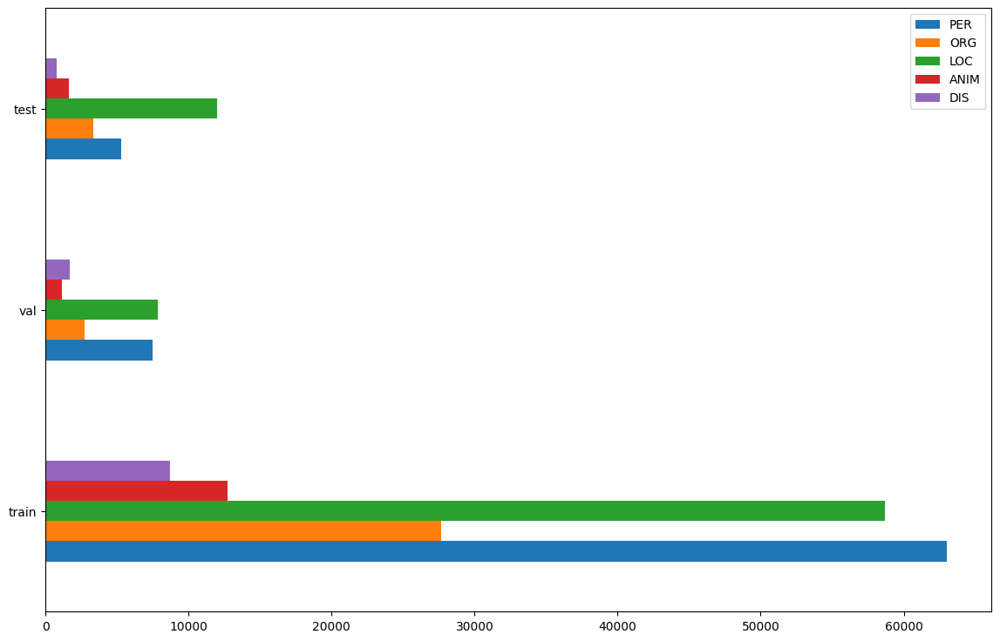

In [ ]:
pd.DataFrame.from_dict(masked_freq_dict, orient='index').plot.barh(figsize=(14,9))
plt.show()

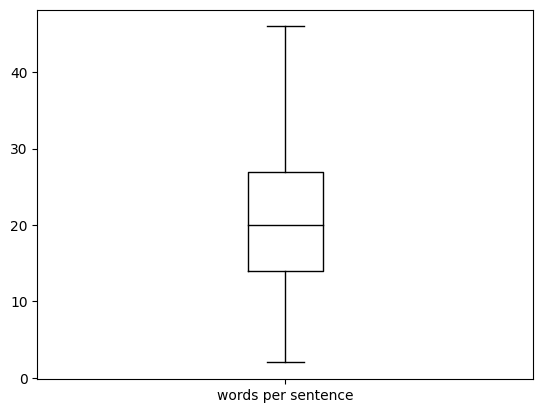

In [ ]:
# check length of sentences:
masked_df_dict['train']["words per sentence"] = masked_df_dict['train']['ner_tags'].apply(len)
masked_df_dict['train'].boxplot('words per sentence', grid=False, showfliers=False, color='black')
plt.show()

## prepare dataset

In [ ]:
multinerd_dataset.reset_format()
# remove lang from feature from dataset
try:
  multinerd_dataset = multinerd_dataset.remove_columns('lang')
except:
  pass

In [ ]:
if masked_training:
  label2id = {l:i for l,i in label_str2ind_dict.items() if l != 'O' and l.split('-')[1] in selected_categories}
  label2id = {'O':0} | label2id
  label2id = {label: i for i, label in enumerate(label2id)}
else:
  label2id = label_str2ind_dict

id2label = {i:l for l,i in label2id.items()}

In [ ]:
# get a copy of dataset to mask for training
import copy
selected_categories = ['PER', 'ORG', 'LOC', 'DIS', 'ANIM']

print(multinerd_dataset)
masked_dataset = copy.deepcopy(multinerd_dataset)

def mask_cats_in_dataset(example):
  new_tags = []
  for tag in example['ner_tags']:
    if tag == 0 or label_ind2str_dict[tag].split('-')[1] in selected_categories:
      new_tag = label2id[label_ind2str_dict[tag]]
    else:
      new_tag = 0
    new_tags.append(new_tag)
  example['ner_tags'] = new_tags
  return example

masked_dataset = masked_dataset.map(mask_cats_in_dataset)

DatasetDict({
    train: Dataset({
        features: ['tokens', 'ner_tags'],
        num_rows: 131280
    })
    test: Dataset({
        features: ['tokens', 'ner_tags'],
        num_rows: 16454
    })
    val: Dataset({
        features: ['tokens', 'ner_tags'],
        num_rows: 16410
    })
})


Map:   0%|          | 0/131280 [00:00<?, ? examples/s]

Map:   0%|          | 0/16454 [00:00<?, ? examples/s]

Map:   0%|          | 0/16410 [00:00<?, ? examples/s]

In [ ]:
print(multinerd_dataset['train'][60]['ner_tags'], masked_dataset['train'][60]['ner_tags'])

[0, 0, 0, 0, 0, 0, 0, 0, 25, 0, 0, 0, 0, 0] [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


#Tokenization


In [ ]:
if masked_training:
  dataset = masked_dataset
else:
  dataset = multinerd_dataset

In [ ]:
from transformers import AutoTokenizer, DistilBertTokenizer

model_ckpt = 'distilbert-base-uncased'
tokenizer = AutoTokenizer.from_pretrained(model_ckpt)

tokenizer_config.json:   0%|          | 0.00/28.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/483 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

In [ ]:
example = dataset["train"][0]
tokenized_input = tokenizer(example["tokens"], is_split_into_words=True)
tokens = tokenizer.convert_ids_to_tokens(tokenized_input["input_ids"])
print(tokens, tokenized_input.word_ids())

['[CLS]', 'the', 'type', 'locality', 'is', 'ki', '##lau', '##ea', '.', '[SEP]'] [None, 0, 1, 2, 3, 4, 4, 4, 5, None]


In [ ]:
def tokenize_and_align_labels(examples):
    tokenized_inputs = tokenizer(examples["tokens"], truncation=True, is_split_into_words=True)

    labels = []
    for i, label in enumerate(examples[f"ner_tags"]):
        word_ids = tokenized_inputs.word_ids(batch_index=i)  # Map tokens to their respective word.
        previous_word_idx = None
        label_ids = []
        for word_idx in word_ids:  # Set the special tokens to -100 (ignore index of cross entropy loss in pytorch)
            if word_idx is None:
                label_ids.append(-100)
            elif word_idx != previous_word_idx:  # Only label the first token of a given word.
                label_ids.append(label[word_idx])
            else:
                label_ids.append(-100)
            previous_word_idx = word_idx
        labels.append(label_ids)

    tokenized_inputs["labels"] = labels
    return tokenized_inputs

In [ ]:
tokenized_multinerd = dataset.map(tokenize_and_align_labels, batched=True)

Map:   0%|          | 0/131280 [00:00<?, ? examples/s]

Map:   0%|          | 0/16454 [00:00<?, ? examples/s]

Map:   0%|          | 0/16410 [00:00<?, ? examples/s]

In [ ]:
from transformers import DataCollatorForTokenClassification

data_collator = DataCollatorForTokenClassification(tokenizer=tokenizer)

In [ ]:
import evaluate

seqeval = evaluate.load("seqeval")

In [ ]:
import numpy as np

labels = [id2label[i] for i in example[f"ner_tags"]]
labels

['O', 'O', 'O', 'O', 'B-LOC', 'O']

In [ ]:
# def convert_label(category, inp):
#   if 'B-' + category == inp:
#     return inp
#   else:
#     return 'not-' + category

def compute_metrics(p):
    predictions, labels = p
    predictions = np.argmax(predictions, axis=2)

    true_predictions = [
        [id2label[p] for (p, l) in zip(prediction, label) if l != -100]
        for prediction, label in zip(predictions, labels)
    ]
    true_labels = [
        [id2label[l] for (p, l) in zip(prediction, label) if l != -100]
        for prediction, label in zip(predictions, labels)
    ]

    results = seqeval.compute(predictions=true_predictions, references=true_labels)
    print(results)
    out = {}
    for sc in selected_categories:
      try:
        out[sc+'-precision'] = results[sc]['precision']
        out[sc+'-recall'] = results[sc]['recall']
        out[sc+'-f1'] = results[sc]['f1']
      except:
        try:
          out[sc+'-precision'] = results['B-'+sc]['precision']
          out[sc+'-recall'] = results['B-'+sc]['recall']
          out[sc+'-f1'] = results['B-'+sc]['f1']
        except:
          pass

    return {
        "precision": results["overall_precision"],
        "recall": results["overall_recall"],
        "f1": results["overall_f1"],
        "accuracy": results["overall_accuracy"],
    } | out

#train model


In [ ]:
from transformers import AutoModelForTokenClassification, TrainingArguments, Trainer

num_labels = len(label2id)
model = AutoModelForTokenClassification.from_pretrained(
    "distilbert-base-uncased", num_labels=num_labels, id2label=id2label, label2id=label2id
)

Some weights of DistilBertForTokenClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
from huggingface_hub import notebook_login

notebook_login()

In [ ]:
# training on the original dataset
training_args = TrainingArguments(
    output_dir="en-multinerd-ner-more-training",
    learning_rate=2e-5,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    num_train_epochs=4,
    weight_decay=0.01,
    evaluation_strategy="epoch",
    save_strategy="epoch",
    load_best_model_at_end=True,
    push_to_hub=True,
)

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=tokenized_multinerd["train"],
    eval_dataset=tokenized_multinerd["val"],
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics,
)

trainer.train()

Epoch,Training Loss,Validation Loss,Precision,Recall,F1,Accuracy,Per-precision,Per-recall,Per-f1,Org-precision,Org-recall,Org-f1,Loc-precision,Loc-recall,Loc-f1,Dis-precision,Dis-recall,Dis-f1,Anim-precision,Anim-recall,Anim-f1
1,0.044700,0.052388,0.858287,0.901002,0.879126,0.980766,0.993885,0.995871,0.994877,0.884563,0.954695,0.918292,0.962561,0.972739,0.967623,0.647209,0.745723,0.692982,0.660728,0.752205,0.703505
2,0.030900,0.050255,0.880025,0.902769,0.891252,0.982515,0.994021,0.996537,0.995277,0.930391,0.947388,0.938812,0.963965,0.971210,0.967574,0.707248,0.736873,0.721757,0.676518,0.746914,0.709975
3,0.020900,0.051987,0.890814,0.904190,0.897452,0.983642,0.995344,0.996670,0.996006,0.936462,0.947753,0.942074,0.968003,0.975032,0.971505,0.716279,0.726844,0.721523,0.701331,0.743386,0.721747
4,0.013800,0.056299,0.894214,0.904996,0.899572,0.983647,0.995211,0.996537,0.995873,0.941198,0.947388,0.944283,0.969110,0.975159,0.972125,0.715664,0.743953,0.729534,0.687029,0.723986,0.705024


TrainOutput(global_step=32820, training_loss=0.03376970503259039, metrics={'train_runtime': 3331.5926, 'train_samples_per_second': 157.618, 'train_steps_per_second': 9.851, 'total_flos': 7480004831450496.0, 'train_loss': 0.03376970503259039, 'epoch': 4.0})

In [ ]:
trainer.push_to_hub()

events.out.tfevents.1702571908.1de977380459.590.3:   0%|          | 0.00/21.3k [00:00<?, ?B/s]

'https://huggingface.co/pariakashani/en-multinerd-ner-more-training/tree/main/'

In [ ]:
# training on the masked dataset
training_args = TrainingArguments(
    output_dir="en-multinerd-masked-ner-more-training",
    learning_rate=2e-5,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    num_train_epochs=5,
    weight_decay=0.01,
    evaluation_strategy="epoch",
    save_strategy="epoch",
    load_best_model_at_end=True,
    push_to_hub=True,
)

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=tokenized_multinerd["train"],
    eval_dataset=tokenized_multinerd["val"],
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics,
)

trainer.train()

You're using a DistilBertTokenizerFast tokenizer. Please note that with a fast tokenizer, using the `__call__` method is faster than using a method to encode the text followed by a call to the `pad` method to get a padded encoding.


Epoch,Training Loss,Validation Loss,Precision,Recall,F1,Accuracy,Per-precision,Per-recall,Per-f1,Org-precision,Org-recall,Org-f1,Loc-precision,Loc-recall,Loc-f1,Dis-precision,Dis-recall,Dis-f1,Anim-precision,Anim-recall,Anim-f1
1,0.024300,0.027133,0.918411,0.945801,0.931905,0.990631,0.992700,0.996270,0.994482,0.883753,0.949945,0.915654,0.958611,0.970701,0.964618,0.671935,0.727434,0.698584,0.665890,0.755732,0.707972
2,0.015900,0.026319,0.932368,0.944845,0.938565,0.991665,0.991255,0.996537,0.993889,0.923678,0.950676,0.936982,0.961272,0.973885,0.967538,0.712791,0.723304,0.718009,0.698971,0.718695,0.708696
3,0.010100,0.029505,0.939593,0.942647,0.941118,0.991942,0.993491,0.996270,0.994879,0.935202,0.938619,0.936907,0.970405,0.973248,0.971825,0.716773,0.728614,0.722645,0.714286,0.705467,0.709849
4,0.005700,0.033473,0.937467,0.946518,0.941971,0.991929,0.996666,0.995471,0.996068,0.934054,0.947022,0.940493,0.969440,0.973885,0.971657,0.706504,0.749853,0.727533,0.705227,0.725750,0.715341
5,0.004000,0.037138,0.938609,0.945562,0.942073,0.991974,0.996004,0.996137,0.996071,0.936433,0.941907,0.939162,0.971940,0.975159,0.973547,0.705882,0.736283,0.720762,0.703325,0.727513,0.715215


TrainOutput(global_step=41025, training_loss=0.01474740565131889, metrics={'train_runtime': 4147.8823, 'train_samples_per_second': 158.249, 'train_steps_per_second': 9.891, 'total_flos': 9349187020979904.0, 'train_loss': 0.01474740565131889, 'epoch': 5.0})

In [ ]:
trainer.push_to_hub()

events.out.tfevents.1702577399.1de977380459.590.4:   0%|          | 0.00/24.6k [00:00<?, ?B/s]

'https://huggingface.co/pariakashani/en-multinerd-masked-ner-more-training/tree/main/'

In [ ]:
trainer.push_to_hub()

events.out.tfevents.1702569965.1de977380459.590.2:   0%|          | 0.00/13.4k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/266M [00:00<?, ?B/s]

Upload 3 LFS files:   0%|          | 0/3 [00:00<?, ?it/s]

training_args.bin:   0%|          | 0.00/4.73k [00:00<?, ?B/s]

'https://huggingface.co/pariakashani/en-multinerd-ner/tree/main/'

#Handle imbalanced data
oversampling: We randomely repeat samples with ANIM and DIS labels to increase samples from these classes in the dataset and solve the issue. (not successful)

In [ ]:
def upsample_rare_classes(example):
  print(example)
  anim_tag , dis_tag = label2id['B-ANIM'], label2id['B-DIS']
  new_tokens = []
  new_tags = []
  new_input_ids = []
  new_attention_masks = []
  new_labels = []
  new_tokens.extend(example['tokens'])
  new_tags.extend(example['ner_tags'])
  new_input_ids.extend(example['input_ids'])
  new_attention_masks.extend(example['attention_mask'])
  new_labels.extend(example['labels'])
  for i, tags in enumerate(example['ner_tags']):
    if anim_tag in tags or dis_tag in tags:
        new_tokens.append(example['tokens'][i])
        new_tags.append(example['ner_tags'][i])
        new_input_ids.append(example['input_ids'][i])
        new_attention_masks.append(example['attention_mask'][i])
        new_labels.append(example['labels'][i])
  example['tokens'] = new_tokens
  example['ner_tags'] = new_tags
  example['input_ids'] = new_input_ids
  example['attention_mask'] = new_attention_masks
  example['labels'] = new_labels
  return example

train_dataset = tokenized_multinerd['train'].map(upsample_rare_classes, batched=True)
train_dataset = train_dataset.shuffle(seed=42)

Map:   0%|          | 0/131280 [00:00<?, ? examples/s]

{'tokens': [['The', 'type', 'locality', 'is', 'Kīlauea', '.'], ['Common', 'components', 'of', 'the', 'herb', 'layer', 'in', 'bogs', 'includes', 'the', 'carnivorous', 'plants', ':', 'round-leaved', 'sundew', '(', '"', 'Drosera', 'rotundifolia', '"', ')', ',', 'and', 'pitcher', 'plant', '(', '"', 'Sarracenia', 'purpurea', '"', ')', '.'], ['The', 'film', 'starred', 'Tito', 'Lusiardo', 'and', 'a', '19-year', '-', 'old', 'Amelia', 'Bence', '.'], ['Created', 'by', 'James', 'Cameron', 'and', 'Charles', 'H.', 'Eglee', ',', 'it', 'stars', 'Jessica', 'Alba', 'in', 'her', 'breakthrough', 'role', '.'], ['The', 'song', 'was', 'written', 'by', 'Sarah', 'Buxton', ',', 'Rodney', 'Clawson', 'and', 'Chris', 'Tompkins', '.'], ['The', 'main', 'story', 'has', 'also', 'continued', 'in', 'novel', 'form', ',', 'written', 'by', 'Greg', 'Rucka', '.'], ['Studies', 'examining', 'shy', 'adolescents', 'and', 'university', 'students', 'found', 'that', 'between', '12', 'and', '18', '%', 'of', 'shy', 'individuals', 'm

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub data rate 

{'tokens': [['More', 'recently', ',', 'Angela', 'Barry', 'has', 'won', 'critical', 'recognition', 'for', 'her', 'published', 'fiction', '.'], ['However', ',', 'the', 'Mobile', 'River', 'system', 'has', 'a', 'high', 'incidence', 'of', 'endemism', 'among', 'freshwater', 'mollusks', 'and', 'biodiversity', 'is', 'high', '.'], ['Coypu', 'and', 'nine-banded', 'armadillo', 'have', 'been', 'introduced', 'to', 'the', 'state', 'and', 'now', 'also', 'common', '.'], ['Drinking', 'any', 'contaminated', 'water', 'and', 'eating', 'any', 'foods', 'washed', 'in', 'the', 'water', ',', 'as', 'well', 'as', 'shellfish', 'living', 'in', 'the', 'affected', 'waterway', ',', 'can', 'cause', 'a', 'person', 'to', 'contract', 'an', 'infection', '.'], ['In', '1993', ',', 'Gonzalo', 'Sánchez', 'de', 'Lozada', 'was', 'elected', 'president', 'in', 'alliance', 'with', 'the', 'Tupac', 'Katari', 'Revolutionary', 'Liberation', 'Movement', ',', 'which', 'inspired', 'indigenous-sensitive', 'and', 'multicultural-aware', 'po

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'tokens': [['Ground-cuckoos', 'of', 'the', 'genus', '"', 'Neomorphus', '"', 'are', 'sometimes', 'seen', 'feeding', 'in', 'association', 'with', 'army', 'ant', 'swarms', ',', 'although', 'they', 'are', 'not', 'obligate', 'ant-followers', 'as', 'are', 'some', 'antbirds', '.'], ['The', 'chip', 'was', 'launched', 'on', '27', 'June', '2008', 'in', 'an', 'event', 'with', 'hundreds', 'of', 'viewers', 'which', 'included', 'a', 'performance', 'from', 'Melissa', 'Tkautz', '.'], ['Laurence', 'Harvey', 'and', 'John', 'Wayne', 'were', 'also', 'going', 'to', 'appear', 'in', 'one', 'sequence', 'together', '.'], ['Butterflies', 'in', 'the', 'region', 'include', 'the', 'dingy', 'skipper', ',', 'brown', 'argus', ',', 'small', 'blue', 'and', 'white-letter', 'hairstreak', '.'], ['Overnight', 'soaked', 'beans', 'put', 'in', 'cold', 'water', ',', 'add', 'butter', 'and', 'laurel', 'leaf', ',', 'then', 'boil', '.'], ['Only', 'Finland', 'has', 'stable', 'repository', 'plans', ',', 'therefore', 'from', 'a', 'w

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'tokens': [['Both', 'bowhead', 'whales', 'and', 'belugas', 'winter', 'in', 'the', 'waters', 'of', 'northeastern', 'Hudson', 'Bay', '.'], ['In', 'the', 'late', '1980', 's', 'and', '1990', 's', ',', 'after', 'a', 'stroke', ',', 'he', 'made', 'performances', 'and', 'recordings', 'with', 'his', 'protégé', 'Benny', 'Green', '.'], ['The', 'southern', 'branch', 'runs', 'south', 'through', 'Ukraine', '.'], ['His', 'draft', 'picks', 'included', 'Alex', 'Rodriguez', ',', 'Jason', 'Varitek', ',', 'Derek', 'Lowe', ',', 'Bret', 'Boone', 'and', 'Raúl', 'Ibañez', '.'], ['Among', 'these', 'dinosaurs', 'was', '"', 'Camarasaurus', '"', ',', 'one', 'of', 'the', 'most', 'recognizable', 'dinosaur', 'recreations', 'of', 'the', 'time', '.'], ['The', 'district', 'lies', 'in', 'the', 'Tapi', 'River', 'and', 'Godavari', 'River', 'basins', '.'], ['The', '"', 'Cfa', '"', 'climate', 'is', 'the', 'result', 'of', 'adiabatic', 'warming', 'of', 'the', 'Appalachians', ',', 'low', 'altitude', 'and', 'proximity', 'to', 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'tokens': [['At', 'these', 'early', 'stages', ',', 'Sammy', 'Cahn', 'as', 'well', 'as', 'Johnny', 'Mercer', 'and', 'Henry', 'Mancini', 'were', 'rumored', 'to', 'do', 'the', 'music', '.'], ['The', 'main', 'title', 'sequence', 'was', 'designed', 'by', 'Pablo', 'Ferro', '(', '1935', '–', '2018', ')', ',', 'who', 'was', 'also', 'an', 'uncredited', 'editor', 'on', 'the', 'film', '.'], ['The', 'film', 'stars', 'John', 'Barrymore', 'and', 'co-stars', 'Marian', 'Marsh', '.'], ['This', 'is', 'the', 'band', "'s", 'first', 'album', 'with', 'their', 'classic', 'line-up', ',', 'adding', 'new', 'bassist', 'Christian', 'Olde', 'Wolbers', '.'], ['Distribution', 'is', 'similar', 'to', 'that', 'of', '"', 'Houlletia', '"', '.'], ['The', 'screenplay', 'by', 'John', 'Michael', 'Hayes', 'is', 'based', 'on', 'the', '1934', 'play', 'of', 'the', 'same', 'title', 'by', 'Lillian', 'Hellman', '.'], ['The', 'film', 'stars', 'Audrey', 'Hepburn', ',', 'Shirley', 'MacLaine', ',', 'and', 'James', 'Garner', '.'], ['"'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'tokens': [['She', 'is', 'not', 'only', 'famous', 'as', 'a', 'solo', 'concert', 'pianist', ',', 'but', 'is', 'also', 'well', 'known', 'for', 'her', 'chamber', 'music', 'playing', 'in', 'cooperation', 'with', 'artists', 'such', 'as', 'Catherine', 'Collard', ',', 'Pierre', 'Amoyal', ',', 'Frédéric', 'Lodéon', ',', 'and', 'Imogen', 'Cooper', '.'], ['"', 'Girella', 'fimbriata', '"', ',', 'the', '"', 'caramel', 'drummer', '"', ',', 'is', 'a', 'species', 'of', 'sea', 'chub', 'endemic', 'to', 'the', 'waters', 'around', 'the', 'Kermadec', 'Islands', 'on', 'reefs', 'at', 'a', 'depth', 'of', 'about', '.'], ['He', 'began', 'his', 'career', 'with', 'Queen', "'s", 'Park', 'in', '2004', 'where', 'he', 'played', 'in', '78', 'league', 'games', ',', 'scoring', '22', 'goals', 'in', 'three', 'seasons', 'with', 'the', 'club', '.'], ['The', 'show', 'was', 'a', 'fish-out-of-water', 'piece', ',', 'which', ',', 'like', 'its', 'contemporary', '"', 'The', 'Beverly', 'Hillbillies', '"', ',', 'featured', 'rural'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'tokens': [['A', 'schizothymic', 'individual', 'displays', 'a', 'flat', 'affect', 'and', 'a', 'high', 'degree', 'of', 'introversion', ',', 'withdrawing', 'from', 'social', 'relations', 'generally', ';', 'nevertheless', ',', 'some', 'individuals', 'with', 'this', 'characteristic', 'may', 'be', 'able', 'to', 'achieve', 'relatively', 'affable', 'social', 'relations', 'and', 'a', 'measure', 'of', 'affectivity', 'in', 'some', 'situations', '.'], ['He', 'played', 'an', 'important', 'part', 'in', 'West', 'Ham', "'s", 'win', 'against', 'Manchester', 'City', 'on', '1', 'March', '2009', 'by', 'providing', 'the', 'assist', 'for', 'Jack', 'Collison', "'s", '71st', '-', 'minute', 'goal', '.'], ['He', 'was', 'sold', 'to', 'Fiorentina', 'for', '€', '2.7', 'million', 'cash', ',', 'with', 'Manuel', 'da', 'Costa', 'going', 'the', 'other', 'way', 'as', 'part', 'of', 'the', 'deal', 'for', 'free', '.'], ['National', 'Doughnut', 'Day', 'celebrates', 'the', 'doughnut', "'s", 'history', 'and', 'role', 'in', 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'tokens': [['His', 'previous', 'best', 'was', '17', 'rebounds', ',', 'which', 'he', 'recorded', 'earlier', 'in', 'the', 'week', 'against', 'the', 'New', 'Orleans', 'Pelicans', '.'], ['On', 'January', '12', ',', 'he', 'recorded', '24', 'points', 'and', '11', 'rebounds', 'in', 'a', '112', '–', '108', 'loss', 'to', 'the', 'Miami', 'Heat', '.'], ['It', 'was', 'formed', 'by', 'merging', 'more', 'than', '80', 'independent', 'coal', 'mines', 'and', 'river', 'transportation', 'businesses', ',', 'both', 'in', 'Pennsylvania', 'and', 'Kentucky', '.'], ['Susan', 'Blackmore', 'writes', 'that', 'melodies', 'from', 'Beethoven', "'s", 'symphonies', 'are', 'commonly', 'used', 'to', 'illustrate', 'the', 'difficulty', 'involved', 'in', 'delimiting', 'memes', 'as', 'discrete', 'units', '.'], ['The', 'railroad', 'was', 'originally', 'opened', 'in', '1878', '(', 'the', 'same', 'year', 'that', 'the', 'mine', 'opened', ')', 'as', 'a', 'narrow', 'gauge', 'line', 'by', 'the', 'H.B.', 'Hays', 'and', 'Brothers',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'tokens': [['Previously', ',', 'he', 'had', 'been', 'drafted', 'by', 'the', 'Detroit', 'Tigers', 'and', 'Minnesota', 'Twins', ',', 'but', 'did', 'not', 'sign', 'with', 'either', 'team', '.'], ['In', 'Java', ',', 'a', 'local', 'version', 'of', 'ginger', 'tea', 'enriched', 'with', 'palm', 'sugar', 'and', 'spices', 'called', '"', 'wedang', 'jahe', '"', 'is', 'more', 'popular', '.'], ['In', 'December', '2014', ',', 'the', 'movie', 'was', 'announced', 'as', 'complete', 'and', 'due', 'for', 'release', 'in', 'China', 'in', 'December', '2015', 'after', 'almost', 'five', 'years', 'of', 'post-production', ',', 'mostly', 'coming', 'from', 'the', 'visual', 'effects', ',', 'which', 'had', 'increased', 'the', 'budget', 'to', 'well', 'over', 'US', '$', '140', 'million', '.'], ['Threats', 'to', 'wild', 'orangutan', 'populations', 'include', 'poaching', ',', 'habitat', 'destruction', 'because', 'of', 'palm', 'oil', 'cultivation', ',', 'and', 'the', 'illegal', 'pet', 'trade', '.'], ['In', 'August', '19

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'tokens': [['The', 'lakes', 'lie', 'in', 'the', 'far', 'west', 'region', 'of', 'New', 'South', 'Wales', ',', 'Australia', ',', 'near', 'the', 'town', 'of', 'Menindee', '.'], ['Seven', 'of', 'the', 'lakes', 'have', 'been', 'incorporated', 'in', 'an', 'artificially', 'regulated', 'overflow', 'system', 'providing', 'both', 'for', 'flood', 'mitigation', 'and', 'as', 'storage', 'for', 'domestic', 'use', ',', 'livestock', 'and', 'irrigation', 'downstream', '.'], ['In', 'September', '1923', ',', 'he', 'joined', 'Olympique', 'Lillois', '.'], ['Manager', 'Owen', 'Coyle', 'said', ':', '"', 'He', 'can', 'play', 'as', 'a', 'striker', ',', 'or', 'behind', 'the', 'striker', 'or', 'wide', 'or', 'as', 'a', 'central', 'midfielder', '.'], ['The', 'film', 'was', 'also', 'adapted', 'for', 'radio', 'with', 'a', 'young', 'John', 'Meillon', '.'], ['It', 'is', 'found', 'in', 'the', 'southern', 'part', 'of', 'the', 'Arabian', 'peninsula', ',', 'including', 'southern', 'Saudi', 'Arabia', '(', 'the', 'Asir', 'M

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'tokens': [['In', 'August', '2012', 'he', 'moved', 'abroad', 'to', 'Serbia', 'by', 'joining', 'OFK', 'Beograd', '.'], ['He', 'made', 'his', 'debut', 'in', 'the', '2012', '–', '13', 'Serbian', 'SuperLiga', 'on', '19', 'August', '2012', ',', 'in', 'a', 'second', 'round', 'match', 'against', 'FK', 'Jagodina', '.'], ['Nonetheless', ',', 'peripheral', 'nationalism', 'may', 'also', 'emerge', 'in', 'regions', 'with', '"', 'lesser', '"', 'economic', 'development', ',', 'as', 'was', 'the', 'case', 'in', 'Ireland', 'or', 'Scotland', '.'], ['He', 'then', 'played', 'the', 'violin', 'in', 'orchestras', 'before', 'taking', 'courses', 'in', 'conducting', 'under', 'Ferdinand', 'Leitner', 'in', '1954', 'and', '1955', '.'], ['It', 'was', 'to', 'also', 'feature', 'season', 'ten', 'winner', 'Alisan', 'Porter', ',', 'Mary', 'Sarah', '(', 'season', '10', ')', ',', 'Matthew', 'Schuler', '(', 'season', '5', ')', ',', 'and', 'Matt', 'McAndrew', '(', 'season', '7', ')', ',', 'and', 'to', 'be', 'backed', 'by', 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'tokens': [['"', 'Mecyclothorax', 'comma', '"', 'is', 'a', 'species', 'of', 'ground', 'beetle', 'in', 'the', 'subfamily', 'Psydrinae', '.'], ['"', 'Mecyclothorax', 'lisae', '"', 'is', 'a', 'species', 'of', 'ground', 'beetle', 'in', 'the', 'subfamily', 'Psydrinae', '.'], ['"', 'Mecyclothorax', 'microps', '"', 'is', 'a', 'species', 'of', 'ground', 'beetle', 'in', 'the', 'subfamily', 'Psydrinae', '.'], ['In', 'the', 'next', 'years', ',', 'key', 'figures', 'from', 'the', 'Independent', 'Smallholders', "'", 'Party', ',', 'e.g.', 'Endre', 'Bajcsy-Zsilinszky', ',', 'had', 'joined', 'the', 'work', 'group', '.'], ['On', '12', 'February', '2014', 'he', 'was', 'loaned', 'out', 'to', 'Teuta', 'Durrës', 'for', 'a', 'half', 'season', '.'], ['It', 'was', 'described', 'by', 'Edward', 'Meyrick', 'in', '1913', '.'], ['It', 'is', 'found', 'in', 'South', 'Africa', '.'], ['"', 'Mecyclothorax', 'fuscus', '"', 'is', 'a', 'species', 'of', 'ground', 'beetle', 'in', 'the', 'subfamily', 'Psydrinae', '.'], ['The

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'tokens': [['Birds', 'are', 'classified', 'as', 'belonging', 'to', 'the', 'subgroup', 'Maniraptora', ',', 'which', 'are', 'coelurosaurs', ',', 'which', 'are', 'theropods', ',', 'which', 'are', 'saurischians', ',', 'which', 'are', 'dinosaurs', '.'], ['The', 'tallest', 'and', 'heaviest', 'dinosaur', 'known', 'from', 'good', 'skeletons', 'is', '"', 'Giraffatitan', 'brancai', '"', '(', 'previously', 'classified', 'as', 'a', 'species', 'of', '"', 'Brachiosaurus', '"', ')', '.'], ['The', 'largest', 'carnivorous', 'dinosaur', 'was', '"', 'Spinosaurus', '"', ',', 'reaching', 'a', 'length', 'of', ',', 'and', 'weighing', '.'], ['However', ',', 'he', 'was', 'unable', 'to', 'stop', 'Juan', 'Ignacio', 'Chela', 'in', 'the', 'third', 'round', '.'], ['A', 'discovery', 'of', 'features', 'in', 'a', '"', 'Tyrannosaurus', 'rex', '"', 'skeleton', 'provided', 'evidence', 'of', 'medullary', 'bone', 'in', 'extinct', 'dinosaurs', 'and', ',', 'for', 'the', 'first', 'time', ',', 'allowed', 'paleontologists', 't

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'tokens': [['The', 'first', 'archaeological', 'evidence', 'of', 'horses', 'used', 'in', 'warfare', 'dates', 'to', 'between', '4000', 'and', '3000', 'BC', ',', 'and', 'the', 'use', 'of', 'horses', 'in', 'warfare', 'was', 'widespread', 'by', 'the', 'end', 'of', 'the', 'Bronze', 'Age', '.'], ['Horses', 'are', 'grazing', 'animals', ',', 'and', 'their', 'major', 'source', 'of', 'nutrients', 'is', 'good-quality', 'forage', 'from', 'hay', 'or', 'pasture', '.'], ['Sometimes', ',', 'concentrated', 'feed', 'such', 'as', 'grain', 'is', 'fed', 'in', 'addition', 'to', 'pasture', 'or', 'hay', ',', 'especially', 'when', 'the', 'animal', 'is', 'very', 'active', '.'], ['She', 'got', 'them', 'safely', 'to', 'Colombo', ',', 'Ceylon', '.'], ['The', 'grave', 'lies', 'in', 'a', 'north-east', 'section', ',', 'off', 'the', 'main', 'paths', ',', 'and', 'is', 'not', 'readily', 'accessible', ',', 'but', 'visible', 'between', 'graves', 'on', 'the', 'east', 'side', 'of', 'the', 'main', 'central-north', 'path', ',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'tokens': [['"', 'Default', 'logic', '"', 'is', 'a', 'non-monotonic', 'logic', 'proposed', 'by', 'Raymond', 'Reiter', 'to', 'formalize', 'reasoning', 'with', 'default', 'assumptions', '.'], ['It', 'has', 'been', 'reported', 'that', 'smuggling', 'one', 'truckload', 'of', 'cigarettes', 'within', 'the', 'United', 'States', 'can', 'lead', 'to', 'a', 'profit', 'of', 'US', '$', '2', 'million', '.'], ['In', 'many', 'parts', 'of', 'the', 'world', ',', 'particularly', 'the', 'Gulf', 'of', 'Mexico', ',', 'the', 'smuggling', 'vessel', 'of', 'choice', 'is', 'the', 'go-fast', 'boat', '.'], ['He', 'scored', 'two', 'more', 'goals', 'throughout', 'August', 'against', 'Scunthorpe', 'United', 'and', 'Bury', '.'], ['and', 'similar', 'ranks', 'in', 'the', 'Indian', 'Armed', 'Forces', ',', 'as', 'per', 'central', 'warrant', 'of', 'precedence', 'in', '1937', '.'], ['In', '2000', ',', 'the', 'government', 'set', 'up', 'a', 'third', 'committee', 'on', 'police', 'reform', ',', 'this', 'time', 'under', 'the', 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'tokens': [['The', 'only', 'mockingbird', 'commonly', 'found', 'in', 'North', 'America', 'is', 'the', 'northern', 'mockingbird', '"', '(', 'Mimus', 'polyglottos', ')', '"', '.'], ['Based', 'on', 'Mary', 'Jane', 'Ward', "'s", '1946', 'semi-autobiographical', 'novel', 'of', 'the', 'same', 'name', ',', 'the', 'film', 'recounts', 'the', 'tale', 'of', 'a', 'woman', 'who', 'finds', 'herself', 'in', 'an', 'insane', 'asylum', 'and', 'cannot', 'remember', 'how', 'she', 'got', 'there', '.'], ['The', 'novel', 'was', 'adapted', 'for', 'the', 'screen', 'by', 'Frank', 'Partos', 'and', 'Millen', 'Brand', ',', 'in', 'screen', 'credits', 'order', ',', 'and', 'Arthur', 'Laurents', '(', 'uncredited', ')', '.'], ['These', 'functions', 'are', 'named', 'after', 'Peter', 'Gustav', 'Lejeune', 'Dirichlet', 'who', 'introduced', 'them', 'in', 'to', 'prove', 'the', 'theorem', 'on', 'primes', 'in', 'arithmetic', 'progressions', 'that', 'also', 'bears', 'his', 'name', '.'], ['On', 'Rotten', 'Tomatoes', ',', 'the',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'tokens': [['A', 'sequel', ',', 'titled', '"', 'Despicable', 'Me', '3', '"', ',', 'was', 'released', 'on', 'June', '30', ',', '2017', '.'], ['Italy', ',', 'Spain', 'and', 'other', 'countries', 'joined', 'it', 'until', 'November', '1941', '.'], ['This', 'marked', 'the', 'beginning', 'of', 'a', 'series', 'of', 'attempts', 'by', 'Adolf', 'Hitler', 'to', 'improve', 'relations', 'between', 'the', 'two', 'countries', '.'], ['Her', 'interest', 'in', 'wildlife', 'was', 'sparked', 'by', 'family', 'vacations', 'to', 'the', 'High', 'Sierras', '.'], ['News', 'and', '"', 'American', 'Morning', '"', '.'], ['Convulsive', 'ergotism', 'causes', 'a', 'variety', 'of', 'symptoms', ',', 'including', 'nervous', 'dysfunction', '.'], ['Witnessing', 'a', 'violent', 'attack', 'is', 'a', 'trigger', 'for', 'hysteria', 'and', 'posttraumatic', 'stress', 'disorder', '.'], ['Work', 'done', 'on', 'tobacco', 'plants', 'revealed', 'a', 'family', 'of', 'glycoproteins', 'called', 'TTS', 'proteins', 'that', 'enhanced', 'g

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'tokens': [['On', 'Rotten', 'Tomatoes', ',', 'the', 'film', 'has', 'an', 'approval', 'rating', 'of', '53', '%', 'based', 'on', '228', 'reviews', ',', 'with', 'an', 'average', 'rating', 'of', '5.95', '/', '10', '.'], ['Since', 'then', ',', 'four', 'players', 'have', 'won', 'the', 'award', 'more', 'than', 'once', ':', 'Darryl', 'Middleton', '(', '3-time', 'winner', ')', ',', 'Arvydas', 'Sabonis', ',', 'Tanoka', 'Beard', ',', 'and', 'Luis', 'Scola', '(', '2-time', 'winners', ')', '.'], ['It', 'is', 'metabolized', 'to', '6-phospho', '-', 'D-gluconate', ';', 'one', 'gram', 'of', 'GDL', 'yields', 'roughly', 'the', 'same', 'amount', 'of', 'metabolic', 'energy', 'as', 'one', 'gram', 'of', 'sugar', '.'], ['He', 'was', 'spotted', 'by', 'Bolton', 'Wanderers', 'just', 'before', 'leaving', 'school', 'at', 'the', 'age', 'of', '15', ',', 'and', 'signed', 'an', 'apprenticeship', 'with', 'the', 'club', '.'], ['The', 'two', 'principal', 'crops', 'used', 'are', 'kenaf', 'and', 'ramie', '.'], ['Blind', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'tokens': [['Engine', 'No.', '124', ',', 'which', 'had', 'been', 'upgraded', 'to', '"', 'As', '"', 'standard', 'in', '1916', ',', 'was', 'involved', 'in', 'an', 'Irish', 'Civil', 'War', 'incident', 'at', 'Streamstown', 'south', 'of', 'Mullingar', 'in', '1923', 'which', 'required', 'it', 'to', 'be', 'totally', 'rebuilt', 'with', 'shortened', 'frames', 'and', 're-designated', '"', 'A1', '"', '.'], ['In', 'addition', 'to', 'desert', 'plants', ',', 'desert', 'tortoises', 'also', 'consume', 'vulture', 'feces', '(', 'which', 'contain', 'bones', ')', ',', 'soil', '(', 'layers', 'contain', 'calcium', ')', ',', 'mammal', 'hairs', ',', 'feathers', ',', 'arthropods', ',', 'stones', ',', 'bones', 'of', 'conspecifics', ',', 'as', 'well', 'as', 'snake', 'and', 'lizard', 'skin', 'castings', '.'], ['HUD', 'technology', 'was', 'next', 'advanced', 'by', 'the', 'Royal', 'Navy', 'in', 'the', 'Buccaneer', ',', 'the', 'prototype', 'of', 'which', 'first', 'flew', 'on', '1958', '.'], ['He', 'made', 'close', 

In [ ]:
from transformers import AutoModelForTokenClassification, TrainingArguments, Trainer

num_labels = len(label2id)
model = AutoModelForTokenClassification.from_pretrained(
    "distilbert-base-uncased", num_labels=num_labels, id2label=id2label, label2id=label2id
)

Some weights of DistilBertForTokenClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
# training on the original dataset
training_args = TrainingArguments(
    output_dir="en-multinerd-ner-unmasked-upsampled",
    learning_rate=2e-5,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    num_train_epochs=3,
    weight_decay=0.01,
    evaluation_strategy="epoch",
    save_strategy="epoch",
    load_best_model_at_end=True,
    push_to_hub=True,
)

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=tokenized_multinerd["val"],
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics,
)

trainer.train()

Epoch,Training Loss,Validation Loss,Precision,Recall,F1,Accuracy,Per-precision,Per-recall,Per-f1,Org-precision,Org-recall,Org-f1,Loc-precision,Loc-recall,Loc-f1,Dis-precision,Dis-recall,Dis-f1,Anim-precision,Anim-recall,Anim-f1
1,0.026200,0.448208,0.869711,0.707231,0.780100,0.962806,0.993216,0.994672,0.993943,0.930479,0.929119,0.929799,0.961970,0.973121,0.967513,0.000000,0.000000,0.000000,0.673989,0.676367,0.675176
2,0.014300,0.570913,0.871412,0.711225,0.783212,0.963046,0.996131,0.994672,0.995401,0.928159,0.939350,0.933721,0.967996,0.970955,0.969473,0.000000,0.000000,0.000000,0.663069,0.758377,0.707528
3,0.008400,0.595255,0.877071,0.711532,0.785676,0.963352,0.994413,0.995871,0.995141,0.932803,0.943369,0.938056,0.969678,0.973631,0.971650,0.000000,0.000000,0.000000,0.685170,0.729277,0.706536


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


{'ANIM': {'precision': 0.6739894551845342, 'recall': 0.6763668430335097, 'f1': 0.6751760563380281, 'number': 1134}, 'BIO': {'precision': 0.0005417118093174431, 'recall': 0.07142857142857142, 'f1': 0.001075268817204301, 'number': 14}, 'CEL': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 94}, 'DIS': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 1695}, 'EVE': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 299}, 'FOOD': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 2120}, 'INST': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 34}, 'LOC': {'precision': 0.9619695252487093, 'recall': 0.9731210191082803, 'f1': 0.9675131403964284, 'number': 7850}, 'MEDIA': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 919}, 'MYTH': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 56}, 'ORG': {'precision': 0.9304793267471643, 'recall': 0.9291194738765072, 'f1': 0.9297989031078611, 'number': 2737}, 'PER': {'precision': 0.9932162809257782, 'recall': 0.99467

/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


{'ANIM': {'precision': 0.6630686198920586, 'recall': 0.7583774250440917, 'f1': 0.7075277663512957, 'number': 1134}, 'BIO': {'precision': 0.000550357732526142, 'recall': 0.07142857142857142, 'f1': 0.0010922992900054616, 'number': 14}, 'CEL': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 94}, 'DIS': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 1695}, 'EVE': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 299}, 'FOOD': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 2120}, 'INST': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 34}, 'LOC': {'precision': 0.967995935991872, 'recall': 0.9709554140127389, 'f1': 0.9694734164334774, 'number': 7850}, 'MEDIA': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 919}, 'MYTH': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 56}, 'ORG': {'precision': 0.9281588447653429, 'recall': 0.9393496529046401, 'f1': 0.9337207190848013, 'number': 2737}, 'PER': {'precision': 0.9961312700106724, 'recall': 0.994671

/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


{'ANIM': {'precision': 0.6851698425849213, 'recall': 0.7292768959435626, 'f1': 0.7065356685177274, 'number': 1134}, 'BIO': {'precision': 0.0005711022272986865, 'recall': 0.07142857142857142, 'f1': 0.00113314447592068, 'number': 14}, 'CEL': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 94}, 'DIS': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 1695}, 'EVE': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 299}, 'FOOD': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 2120}, 'INST': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 34}, 'LOC': {'precision': 0.9696777467647805, 'recall': 0.9736305732484076, 'f1': 0.9716501398423595, 'number': 7850}, 'MEDIA': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 919}, 'MYTH': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 56}, 'ORG': {'precision': 0.9328034682080925, 'recall': 0.9433686518085495, 'f1': 0.9380563124432333, 'number': 2737}, 'PER': {'precision': 0.994413407821229, 'recall': 0.9958705

TrainOutput(global_step=26403, training_loss=0.022740711557392424, metrics={'train_runtime': 2632.8134, 'train_samples_per_second': 160.45, 'train_steps_per_second': 10.028, 'total_flos': 6102240947475624.0, 'train_loss': 0.022740711557392424, 'epoch': 3.0})

In [ ]:
trainer.push_to_hub()

events.out.tfevents.1702678406.92b8de87ec56.1225.2:   0%|          | 0.00/17.9k [00:00<?, ?B/s]

'https://huggingface.co/pariakashani/en-multinerd-ner-unmasked-upsampled/tree/main/'

In [ ]:
trainer.evaluate(tokenized_multinerd['test'])

/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


{'ANIM': {'precision': 0.6907155529272619, 'recall': 0.7281795511221946, 'f1': 0.7089529590288316, 'number': 1604}, 'BIO': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 8}, 'CEL': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 41}, 'DIS': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 759}, 'EVE': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 352}, 'FOOD': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 566}, 'INST': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 12}, 'LOC': {'precision': 0.9615988108018829, 'recall': 0.9683965402528277, 'f1': 0.9649857042224341, 'number': 12024}, 'MEDIA': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 458}, 'MYTH': {'precision': 0.0, 'recall': 0.0, 'f1': 0.0, 'number': 32}, 'ORG': {'precision': 0.9482602118003026, 'recall': 0.9471139317014203, 'f1': 0.9476867251285153, 'number': 3309}, 'PER': {'precision': 0.9922112462006079, 'recall': 0.992022792022792, 'f1': 0.9921170101624086, 'number': 5265}

{'eval_loss': 0.2690820097923279,
 'eval_precision': 0.9117495046946335,
 'eval_recall': 0.8254630532267498,
 'eval_f1': 0.8664633771974705,
 'eval_accuracy': 0.9746329515164613,
 'eval_PER-precision': 0.9922112462006079,
 'eval_PER-recall': 0.992022792022792,
 'eval_PER-f1': 0.9921170101624086,
 'eval_ORG-precision': 0.9482602118003026,
 'eval_ORG-recall': 0.9471139317014203,
 'eval_ORG-f1': 0.9476867251285153,
 'eval_LOC-precision': 0.9615988108018829,
 'eval_LOC-recall': 0.9683965402528277,
 'eval_LOC-f1': 0.9649857042224341,
 'eval_DIS-precision': 0.0,
 'eval_DIS-recall': 0.0,
 'eval_DIS-f1': 0.0,
 'eval_ANIM-precision': 0.6907155529272619,
 'eval_ANIM-recall': 0.7281795511221946,
 'eval_ANIM-f1': 0.7089529590288316,
 'eval_runtime': 36.808,
 'eval_samples_per_second': 447.023,
 'eval_steps_per_second': 27.956,
 'epoch': 3.0}

# use roBERTa instead of DistilBERT

In [ ]:
from transformers import AutoTokenizer

model_ckpt = 'roberta-base'
tokenizer = AutoTokenizer.from_pretrained(model_ckpt,add_prefix_space=True)
tokenizer("Hello world")["input_ids"]

[0, 20920, 232, 2]

In [ ]:
from transformers import DataCollatorForTokenClassification

data_collator = DataCollatorForTokenClassification(tokenizer=tokenizer)

In [ ]:
tokenized_multinerd = dataset.map(tokenize_and_align_labels, batched=True)

Map:   0%|          | 0/131280 [00:00<?, ? examples/s]

Map:   0%|          | 0/16454 [00:00<?, ? examples/s]

Map:   0%|          | 0/16410 [00:00<?, ? examples/s]

In [ ]:
from transformers import AutoModelForTokenClassification, TrainingArguments, Trainer

num_labels = len(label2id)
model = AutoModelForTokenClassification.from_pretrained(
    model_ckpt, num_labels=num_labels, id2label=id2label, label2id=label2id
)

Some weights of RobertaForTokenClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
import numpy as np
# training on the original dataset
training_args = TrainingArguments(
    output_dir="en-multinerd-ner-roberta",
    learning_rate=2e-5,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    num_train_epochs=4,
    weight_decay=0.01,
    evaluation_strategy="epoch",
    save_strategy="epoch",
    load_best_model_at_end=True,
    push_to_hub=True,
)

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=tokenized_multinerd["train"],
    eval_dataset=tokenized_multinerd["val"],
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics,
)

trainer.train()

Epoch,Training Loss,Validation Loss,Precision,Recall,F1,Accuracy,Per-precision,Per-recall,Per-f1,Org-precision,Org-recall,Org-f1,Loc-precision,Loc-recall,Loc-f1,Dis-precision,Dis-recall,Dis-f1,Anim-precision,Anim-recall,Anim-f1
1,0.038000,0.045207,0.874223,0.924043,0.898443,0.983043,0.996267,0.995471,0.995869,0.961621,0.979540,0.970498,0.989354,0.994395,0.991868,0.665792,0.748673,0.704804,0.641469,0.785714,0.706302
2,0.029400,0.040962,0.915412,0.908452,0.911919,0.985639,0.995218,0.998002,0.996608,0.969675,0.981366,0.975486,0.992879,0.994650,0.993764,0.735758,0.716224,0.725859,0.710680,0.645503,0.676525
3,0.020200,0.042888,0.902254,0.925502,0.913730,0.985446,0.994950,0.997336,0.996142,0.979121,0.976617,0.977867,0.990497,0.995796,0.993139,0.718976,0.762242,0.739977,0.724724,0.752205,0.738209
4,0.014900,0.045464,0.912177,0.920548,0.916343,0.985803,0.995478,0.997069,0.996273,0.979510,0.978078,0.978793,0.992758,0.995414,0.994084,0.729485,0.760472,0.744656,0.717354,0.736332,0.726719


{'ANIM': {'precision': 0.6414686825053996, 'recall': 0.7857142857142857, 'f1': 0.7063020214030916, 'number': 1134}, 'BIO': {'precision': 0.6666666666666666, 'recall': 0.2857142857142857, 'f1': 0.4, 'number': 14}, 'CEL': {'precision': 0.875, 'recall': 0.8936170212765957, 'f1': 0.8842105263157894, 'number': 94}, 'DIS': {'precision': 0.6657922350472193, 'recall': 0.7486725663716814, 'f1': 0.7048042210497084, 'number': 1695}, 'EVE': {'precision': 0.9387096774193548, 'recall': 0.9732441471571907, 'f1': 0.9556650246305419, 'number': 299}, 'FOOD': {'precision': 0.5250823874038814, 'recall': 0.6764150943396227, 'f1': 0.5912183055040199, 'number': 2120}, 'INST': {'precision': 0.7272727272727273, 'recall': 0.7058823529411765, 'f1': 0.7164179104477613, 'number': 34}, 'LOC': {'precision': 0.9893536121673003, 'recall': 0.9943949044585987, 'f1': 0.9918678526048283, 'number': 7850}, 'MEDIA': {'precision': 0.9651795429815017, 'recall': 0.9651795429815017, 'f1': 0.9651795429815017, 'number': 919}, 'MYT

TrainOutput(global_step=32820, training_loss=0.03103190691713732, metrics={'train_runtime': 6325.1914, 'train_samples_per_second': 83.02, 'train_steps_per_second': 5.189, 'total_flos': 1.5011930569600224e+16, 'train_loss': 0.03103190691713732, 'epoch': 4.0})

In [ ]:
trainer.evaluate(tokenized_multinerd['test'])

{'ANIM': {'precision': 0.6896762370189371, 'recall': 0.7038653366583542, 'f1': 0.6966985498302992, 'number': 1604}, 'BIO': {'precision': 0.6, 'recall': 0.75, 'f1': 0.6666666666666665, 'number': 8}, 'CEL': {'precision': 0.7391304347826086, 'recall': 0.8292682926829268, 'f1': 0.7816091954022988, 'number': 41}, 'DIS': {'precision': 0.7664907651715039, 'recall': 0.7654808959156785, 'f1': 0.7659854976928148, 'number': 759}, 'EVE': {'precision': 0.9445983379501385, 'recall': 0.96875, 'f1': 0.9565217391304347, 'number': 352}, 'FOOD': {'precision': 0.642023346303502, 'recall': 0.5830388692579506, 'f1': 0.6111111111111112, 'number': 566}, 'INST': {'precision': 0.8181818181818182, 'recall': 0.75, 'f1': 0.7826086956521738, 'number': 12}, 'LOC': {'precision': 0.995914623978656, 'recall': 0.9934298070525616, 'f1': 0.994670663668915, 'number': 12024}, 'MEDIA': {'precision': 0.9587852494577006, 'recall': 0.9650655021834061, 'f1': 0.9619151251360174, 'number': 458}, 'MYTH': {'precision': 0.88, 'recall

{'eval_loss': 0.027955923229455948,
 'eval_precision': 0.9421281891723708,
 'eval_recall': 0.9445895886137649,
 'eval_f1': 0.9433572833304126,
 'eval_accuracy': 0.9903493984583244,
 'eval_PER-precision': 0.9916871339505007,
 'eval_PER-recall': 0.9969610636277303,
 'eval_PER-f1': 0.9943171055124076,
 'eval_ORG-precision': 0.9765976597659766,
 'eval_ORG-recall': 0.9836808703535811,
 'eval_ORG-f1': 0.9801264679313458,
 'eval_LOC-precision': 0.995914623978656,
 'eval_LOC-recall': 0.9934298070525616,
 'eval_LOC-f1': 0.994670663668915,
 'eval_DIS-precision': 0.7664907651715039,
 'eval_DIS-recall': 0.7654808959156785,
 'eval_DIS-f1': 0.7659854976928148,
 'eval_ANIM-precision': 0.6896762370189371,
 'eval_ANIM-recall': 0.7038653366583542,
 'eval_ANIM-f1': 0.6966985498302992,
 'eval_runtime': 60.2199,
 'eval_samples_per_second': 273.232,
 'eval_steps_per_second': 17.087,
 'epoch': 4.0}

In [ ]:
trainer.push_to_hub()

Upload 2 LFS files:   0%|          | 0/2 [00:00<?, ?it/s]

events.out.tfevents.1702753980.b3254f8c941f.9439.2:   0%|          | 0.00/1.39k [00:00<?, ?B/s]

events.out.tfevents.1702745658.b3254f8c941f.9439.1:   0%|          | 0.00/21.4k [00:00<?, ?B/s]

'https://huggingface.co/pariakashani/en-multinerd-ner-roberta/tree/main/'

In [ ]:
trainer.predict(tokenized_multinerd['test'])

{'ANIM': {'precision': 0.6896762370189371, 'recall': 0.7038653366583542, 'f1': 0.6966985498302992, 'number': 1604}, 'BIO': {'precision': 0.6, 'recall': 0.75, 'f1': 0.6666666666666665, 'number': 8}, 'CEL': {'precision': 0.7391304347826086, 'recall': 0.8292682926829268, 'f1': 0.7816091954022988, 'number': 41}, 'DIS': {'precision': 0.7664907651715039, 'recall': 0.7654808959156785, 'f1': 0.7659854976928148, 'number': 759}, 'EVE': {'precision': 0.9445983379501385, 'recall': 0.96875, 'f1': 0.9565217391304347, 'number': 352}, 'FOOD': {'precision': 0.642023346303502, 'recall': 0.5830388692579506, 'f1': 0.6111111111111112, 'number': 566}, 'INST': {'precision': 0.8181818181818182, 'recall': 0.75, 'f1': 0.7826086956521738, 'number': 12}, 'LOC': {'precision': 0.995914623978656, 'recall': 0.9934298070525616, 'f1': 0.994670663668915, 'number': 12024}, 'MEDIA': {'precision': 0.9587852494577006, 'recall': 0.9650655021834061, 'f1': 0.9619151251360174, 'number': 458}, 'MYTH': {'precision': 0.88, 'recall

PredictionOutput(predictions=array([[[ 7.8366032e+00, -8.2348086e-02, -1.6956646e+00, ...,
         -8.5010266e-01, -2.9539933e+00, -2.3901269e+00],
        [ 1.2872734e+01, -1.4763435e+00, -1.7930338e+00, ...,
         -8.1695354e-01, -3.2011490e+00, -3.0844738e+00],
        [ 1.3012182e+01, -1.3618864e+00, -1.9207498e+00, ...,
         -6.9781685e-01, -3.1524448e+00, -3.2492924e+00],
        ...,
        [-1.0000000e+02, -1.0000000e+02, -1.0000000e+02, ...,
         -1.0000000e+02, -1.0000000e+02, -1.0000000e+02],
        [-1.0000000e+02, -1.0000000e+02, -1.0000000e+02, ...,
         -1.0000000e+02, -1.0000000e+02, -1.0000000e+02],
        [-1.0000000e+02, -1.0000000e+02, -1.0000000e+02, ...,
         -1.0000000e+02, -1.0000000e+02, -1.0000000e+02]],

       [[ 6.2470393e+00,  6.0344022e-04, -1.2005520e+00, ...,
         -8.4906548e-01, -2.6274586e+00, -2.0472269e+00],
        [ 1.2865834e+01, -1.5683285e+00, -1.9252636e+00, ...,
         -8.4253931e-01, -3.2834456e+00, -3.2368650e+0